# Imports

In [138]:
!pip install -Uqq fastai && pip install -Uqq torchsummary

In [139]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
import seaborn as sns
import os
from PIL import Image
#from google.colab import files, BROKE MY ENVIRONMENT TRYING TO IMPORT

In [140]:
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import f1_score
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report

In [141]:
import torch
from torchsummary import summary
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
import fastai
assert fastai.__version__ >= '2.3.0', "Please update your FastAI version!"
from fastai.vision.all import *

In [142]:
torch.__version__

'1.10.0+cu111'

In [143]:
fastai.__version__

'2.5.3'

In [144]:
def reset_model(model):
    for name, layer in model.named_children():
        if hasattr(layer, 'reset_parameters'):
            # print(name)
            layer.reset_parameters()

In [145]:
def shuffle_fn(idx):
    np.random.seed(0)
    return np.random.choice(idx, size=len(idx), replace=False)

# Oxford-III Pets Dataset Dogs and Cats CNN

In [60]:
pet_path = untar_data(URLs.PETS)
pet_path

Path('/root/.fastai/data/oxford-iiit-pet')

In [61]:
pet_path.ls()

(#2) [Path('/root/.fastai/data/oxford-iiit-pet/images'),Path('/root/.fastai/data/oxford-iiit-pet/annotations')]

In [62]:
(pet_path / 'images').ls()

(#7393) [Path('/root/.fastai/data/oxford-iiit-pet/images/Ragdoll_119.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Birman_56.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/havanese_69.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Bengal_132.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Bombay_81.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Bengal_191.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/pug_202.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_67.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/scottish_terrier_10.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/great_pyrenees_181.jpg')...]

In [63]:
pet_image_paths = get_image_files((pet_path / 'images'))
pet_image_paths.sort()
pet_image_paths

(#7390) [Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_1.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_10.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_100.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_101.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_102.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_103.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_104.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_105.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_106.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_107.jpg')...]

In [64]:
pet_example = pet_image_paths[1]
pet_example

Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_10.jpg')

In [65]:
pet_example.name

'Abyssinian_10.jpg'

In [66]:
pet_example.name[0]

'A'

In [67]:
pet_example.name[0].isupper()

True

In [68]:
def label_func(fname):
    return "cat" if fname.name[0].isupper() else "dog"

In [69]:
label_func(pet_example)

'cat'

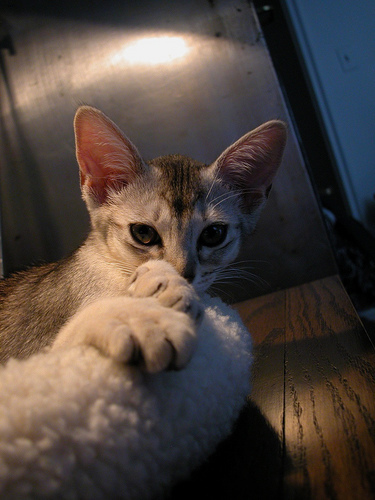

In [70]:
PILImage.create(pet_example)

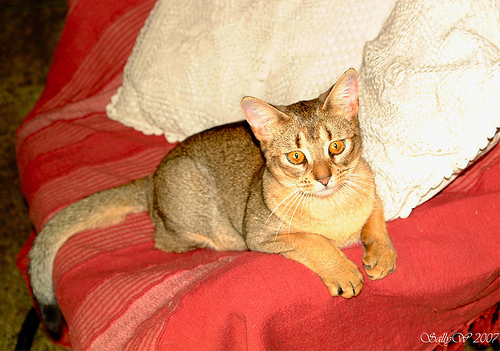

In [71]:
pet_example1 = pet_image_paths[5]
pet_img1 = PILImage.create(pet_example1)
pet_img1
#Example image

In [72]:
pet_img1.shape #CAN REMOVE

(351, 500)

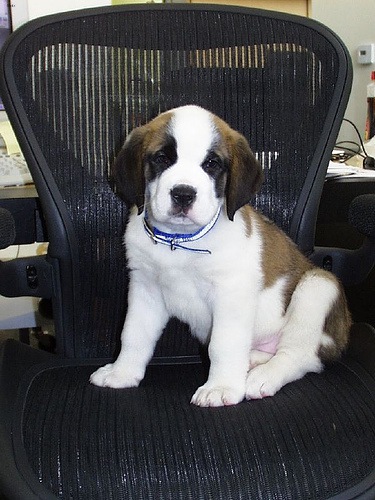

In [73]:
pet_example2 = pet_image_paths[6000]
pet_img2 = PILImage.create(pet_example2)
pet_img2
#Example image

In [74]:
pet_img2.shape#CAN REMOVE

(500, 375)

In [75]:
resize = Resize(128, method='squish')#CAN REMOVE

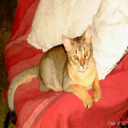

In [76]:
resize(pet_img1)#CAN REMOVE

In [77]:
resize(pet_img1).shape#CAN REMOVE

(128, 128)

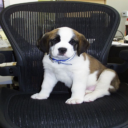

In [78]:
resize(pet_img2)#CAN REMOVE

In [79]:
resize(pet_img2).shape#CAN REMOVE

(128, 128)

In [80]:
labels = []

for i, img_path in enumerate(pet_image_paths):
    img_label = label_func(img_path)
    labels.append(img_label)
    
labels = np.array(labels)
labels

array(['cat', 'cat', 'cat', ..., 'dog', 'dog', 'dog'], dtype='<U3')

In [81]:
tts = TrainTestSplitter(test_size=.1, shuffle=True, stratify=labels, random_state=0)

In [82]:
trn_idx, tst_idx = tts(pet_image_paths)
trn_idx, tst_idx

((#6651) [778,2707,3973,472,3539,1938,1646,3237,815,2749...],
 (#739) [2536,3537,6617,637,1896,3948,5714,2076,807,797...])

In [83]:
trn_cls, trn_cls_cnt = np.unique(labels[list(trn_idx)], return_counts=True)

In [84]:
print("The {} class has for the training data has {} samples".format(trn_cls[0], 
                                                                      trn_cls_cnt[0]))
print("The {} class has for the training data has {} samples".format(trn_cls[1], 
                                                                      trn_cls_cnt[1]))
print("The training data cat-to-dog ratio is {:.5f} or {}/{} ".format(trn_cls_cnt[0]/trn_cls_cnt[1],
                                                                  trn_cls_cnt[0], trn_cls_cnt[1]))

The cat class has for the training data has 2160 samples
The dog class has for the training data has 4491 samples
The training data cat-to-dog ratio is 0.48096 or 2160/4491 


In [85]:
tst_cls, tst_cls_cnt =np.unique(labels[list(tst_idx)], return_counts=True)

In [86]:
print("The {} class has for the training data has {} samples".format(tst_cls[0], 
                                                                      tst_cls_cnt[0]))
print("The {} class has for the training data has {} samples".format(tst_cls[1], 
                                                                      tst_cls_cnt[1]))
print("The testing data cat-to-dog ratio is {:.5f} or {}/{} ".format(tst_cls_cnt[0]/tst_cls_cnt[1],
                                                                  tst_cls_cnt[0], tst_cls_cnt[1]))

The cat class has for the training data has 240 samples
The dog class has for the training data has 499 samples
The testing data cat-to-dog ratio is 0.48096 or 240/499 


In [87]:
trn_paths = pet_image_paths[trn_idx]
tst_paths  = pet_image_paths[tst_idx]

In [88]:
pet_db = DataBlock(
    blocks=(ImageBlock, CategoryBlock()),
    splitter=RandomSplitter(seed=0),
    get_y=label_func,
    item_tfms=Resize(128, method='squish')
)

In [89]:
trn_vld_dls = pet_db.dataloaders(trn_paths, bs=128)

In [90]:
trn_vld_dls.train_ds

(#5321) [(PILImage mode=RGB size=500x375, TensorCategory(1)),(PILImage mode=RGB size=500x333, TensorCategory(0)),(PILImage mode=RGB size=500x333, TensorCategory(0)),(PILImage mode=RGB size=500x376, TensorCategory(0)),(PILImage mode=RGB size=300x215, TensorCategory(1)),(PILImage mode=RGB size=500x375, TensorCategory(0)),(PILImage mode=RGB size=500x375, TensorCategory(1)),(PILImage mode=RGB size=500x375, TensorCategory(1)),(PILImage mode=RGB size=333x500, TensorCategory(1)),(PILImage mode=RGB size=500x333, TensorCategory(0))...]

In [91]:
trn_vld_dls.valid_ds

(#1330) [(PILImage mode=RGB size=500x359, TensorCategory(1)),(PILImage mode=RGB size=375x500, TensorCategory(1)),(PILImage mode=RGB size=500x323, TensorCategory(1)),(PILImage mode=RGB size=500x338, TensorCategory(1)),(PILImage mode=RGB size=352x319, TensorCategory(0)),(PILImage mode=RGB size=480x320, TensorCategory(1)),(PILImage mode=RGB size=500x375, TensorCategory(1)),(PILImage mode=RGB size=300x157, TensorCategory(0)),(PILImage mode=RGB size=500x375, TensorCategory(1)),(PILImage mode=RGB size=500x375, TensorCategory(1))...]

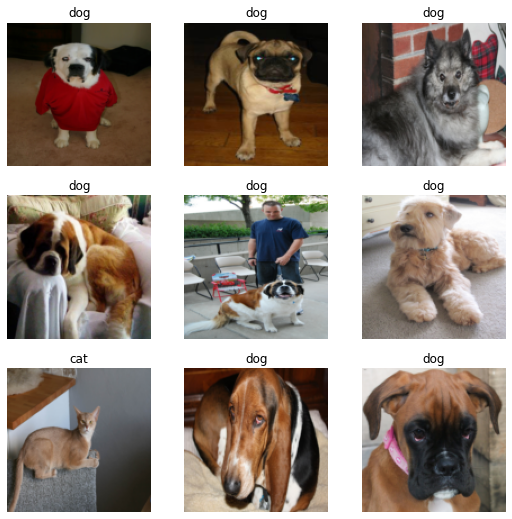

In [92]:
trn_vld_dls.show_batch()

In [93]:
x, y = trn_vld_dls.one_batch()
print("One batch of data has the shape: {}".format(x.shape))
print("One batch of targets has the shape: {}".format(y.shape))

One batch of data has the shape: torch.Size([128, 3, 128, 128])
One batch of targets has the shape: torch.Size([128])


In [94]:
test_dl = trn_vld_dls.test_dl(test_items=tst_paths, with_labels=True)
test_dl.dataset

(#739) [(PILImage mode=RGB size=500x375, TensorCategory(1)),(PILImage mode=RGB size=300x500, TensorCategory(1)),(PILImage mode=RGB size=500x375, TensorCategory(1)),(PILImage mode=RGB size=360x305, TensorCategory(0)),(PILImage mode=RGB size=500x442, TensorCategory(0)),(PILImage mode=RGB size=500x333, TensorCategory(1)),(PILImage mode=RGB size=500x333, TensorCategory(1)),(PILImage mode=RGB size=500x346, TensorCategory(0)),(PILImage mode=RGB size=500x375, TensorCategory(0)),(PILImage mode=RGB size=450x342, TensorCategory(0))...]

In [95]:
cnn_layers = nn.Sequential(
    nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3),
    nn.ReLU(),
    nn.MaxPool2d(kernel_size=2),
    nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3),
    nn.ReLU(),
    nn.MaxPool2d(kernel_size=2),
    nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3),
    nn.ReLU(),
    nn.MaxPool2d(kernel_size=2)
).to(device)

In [96]:
x, y = trn_vld_dls.one_batch()
cnn_output = cnn_layers(x)
cnn_output.shape

torch.Size([128, 128, 14, 14])

In [97]:
fc_layers = nn.Sequential(
    nn.Flatten(),
    nn.Linear(in_features=25088, out_features=128),
    nn.ReLU(),
    nn.Linear(in_features=128, out_features=2),
    nn.LogSoftmax()
).to(device)

In [98]:
fc_output = fc_layers(cnn_output)
fc_output.shape

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


torch.Size([128, 2])

In [99]:
model = nn.Sequential(*cnn_layers, *fc_layers)

In [100]:
summary(model, x.shape[1:]);

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 126, 126]             896
              ReLU-2         [-1, 32, 126, 126]               0
         MaxPool2d-3           [-1, 32, 63, 63]               0
            Conv2d-4           [-1, 64, 61, 61]          18,496
              ReLU-5           [-1, 64, 61, 61]               0
         MaxPool2d-6           [-1, 64, 30, 30]               0
            Conv2d-7          [-1, 128, 28, 28]          73,856
              ReLU-8          [-1, 128, 28, 28]               0
         MaxPool2d-9          [-1, 128, 14, 14]               0
          Flatten-10                [-1, 25088]               0
           Linear-11                  [-1, 128]       3,211,392
             ReLU-12                  [-1, 128]               0
           Linear-13                    [-1, 2]             258
       LogSoftmax-14                   

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:141: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


In [101]:
nll_loss = BaseLoss(nn.NLLLoss)

def decode_nllloss(x):
    return x.argmax(axis=1)
nll_loss.decodes = decode_nllloss

reset_model(model)

learn = Learner(dls=trn_vld_dls,
                model=model,
                loss_func=nll_loss,
                metrics=accuracy,
                opt_func=Adam)

In [102]:
learn.fit(3, .001)

epoch,train_loss,valid_loss,accuracy,time
0,0.633528,0.634504,0.657143,00:54
1,0.619087,0.603921,0.669173,00:46
2,0.579073,0.547718,0.712030,00:46


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


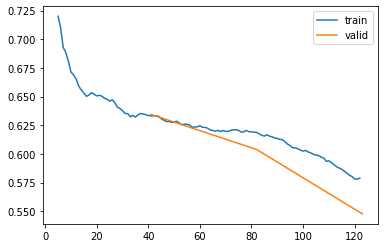

In [103]:
learn.recorder.plot_loss()

In [104]:
tst_logprobs, tst_targets = learn.get_preds(dl=test_dl)

tst_preds = np.argmax(tst_logprobs, axis=0)

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


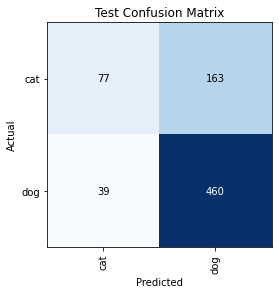

In [105]:
tst_interp = ClassificationInterpretation.from_learner(learn=learn, dl=test_dl)

tst_interp.plot_confusion_matrix(title="Test Confusion Matrix")

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


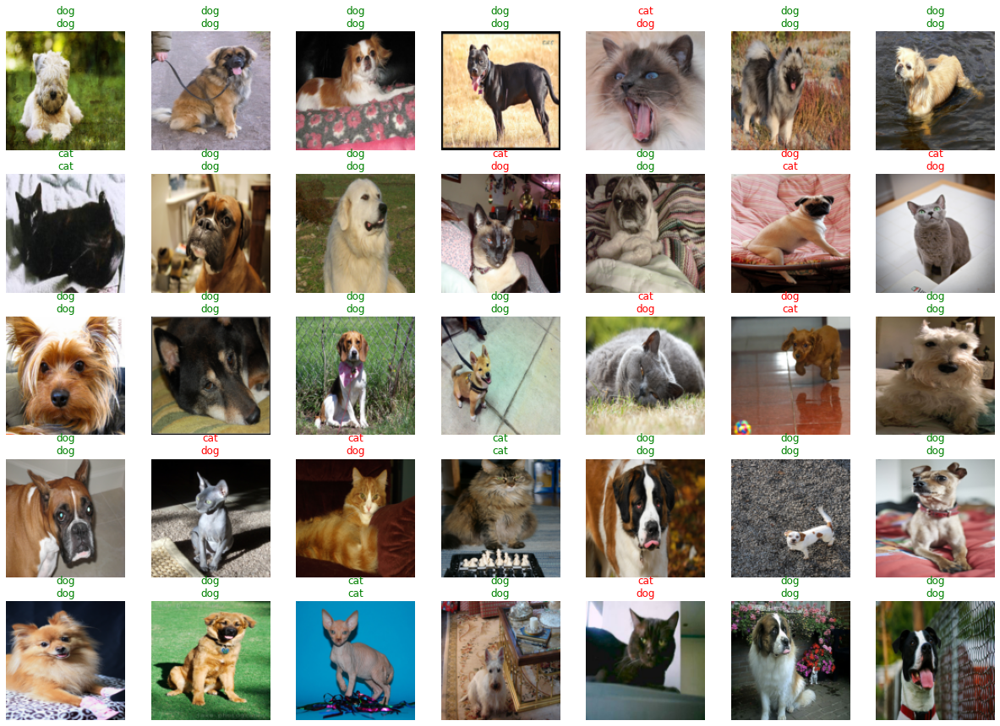

In [106]:
learn.show_results(max_n=35, shuffle=False)

In [107]:
cnn_layers = nn.Sequential(
    nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3),
    nn.ReLU(),
    nn.BatchNorm2d(num_features=32),
    nn.MaxPool2d(kernel_size=2),
    nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3),
    nn.ReLU(),
    nn.BatchNorm2d(num_features=64),
    nn.MaxPool2d(kernel_size=2),
    nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3),
    nn.ReLU(),
    nn.BatchNorm2d(num_features=128),
    nn.MaxPool2d(kernel_size=2)
).to(device)

In [108]:
x, y = trn_vld_dls.one_batch()
cnn_output = cnn_layers(x)
cnn_output.shape

torch.Size([128, 128, 14, 14])

In [109]:
fc_layers = nn.Sequential(
    nn.Flatten(),
    nn.Linear(in_features=25088, out_features=128),
    nn.ReLU(),
    nn.Linear(in_features=128, out_features=2),
    nn.LogSoftmax()
).to(device)

In [110]:
fc_output = fc_layers(cnn_output)
fc_output.shape

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


torch.Size([128, 2])

In [111]:
model = nn.Sequential(*cnn_layers, *fc_layers)

In [112]:
from torchsummary import summary
summary(model, x.shape[1:]);

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 126, 126]             896
              ReLU-2         [-1, 32, 126, 126]               0
       BatchNorm2d-3         [-1, 32, 126, 126]              64
         MaxPool2d-4           [-1, 32, 63, 63]               0
            Conv2d-5           [-1, 64, 61, 61]          18,496
              ReLU-6           [-1, 64, 61, 61]               0
       BatchNorm2d-7           [-1, 64, 61, 61]             128
         MaxPool2d-8           [-1, 64, 30, 30]               0
            Conv2d-9          [-1, 128, 28, 28]          73,856
             ReLU-10          [-1, 128, 28, 28]               0
      BatchNorm2d-11          [-1, 128, 28, 28]             256
        MaxPool2d-12          [-1, 128, 14, 14]               0
          Flatten-13                [-1, 25088]               0
           Linear-14                  [

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:141: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


In [113]:
nll_loss = BaseLoss(nn.NLLLoss)

def decode_nllloss(x):
    return x.argmax(axis=1)
nll_loss.decodes = decode_nllloss

reset_model(model)
learn = Learner(trn_vld_dls, model, opt_func=Adam, loss_func=nll_loss, metrics=accuracy)

In [114]:
learn.fit(3, .001)

epoch,train_loss,valid_loss,accuracy,time
0,0.869544,0.702975,0.601504,00:46
1,0.642851,0.556391,0.708271,00:47
2,0.543029,0.543123,0.727068,00:46


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


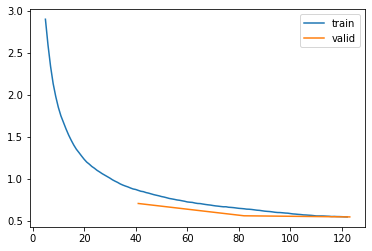

In [115]:
learn.recorder.plot_loss()

In [116]:
tst_logprobs, tst_targets = learn.get_preds(dl=test_dl)
tst_loss, tst_acc = learn.validate(dl=test_dl)
tst_preds = tst_logprobs.argmax(axis=1)
print("Test loss: {:.5f} accuracy: {:.5f}".format(tst_loss, tst_acc))

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Test loss: 0.53784 accuracy: 0.74966


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


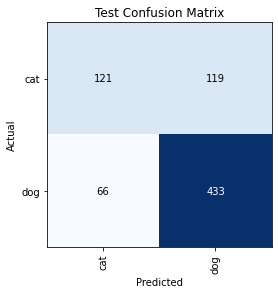

In [117]:
tst_interp = ClassificationInterpretation.from_learner(learn, dl=test_dl)

tst_interp.plot_confusion_matrix(title="Test Confusion Matrix")

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


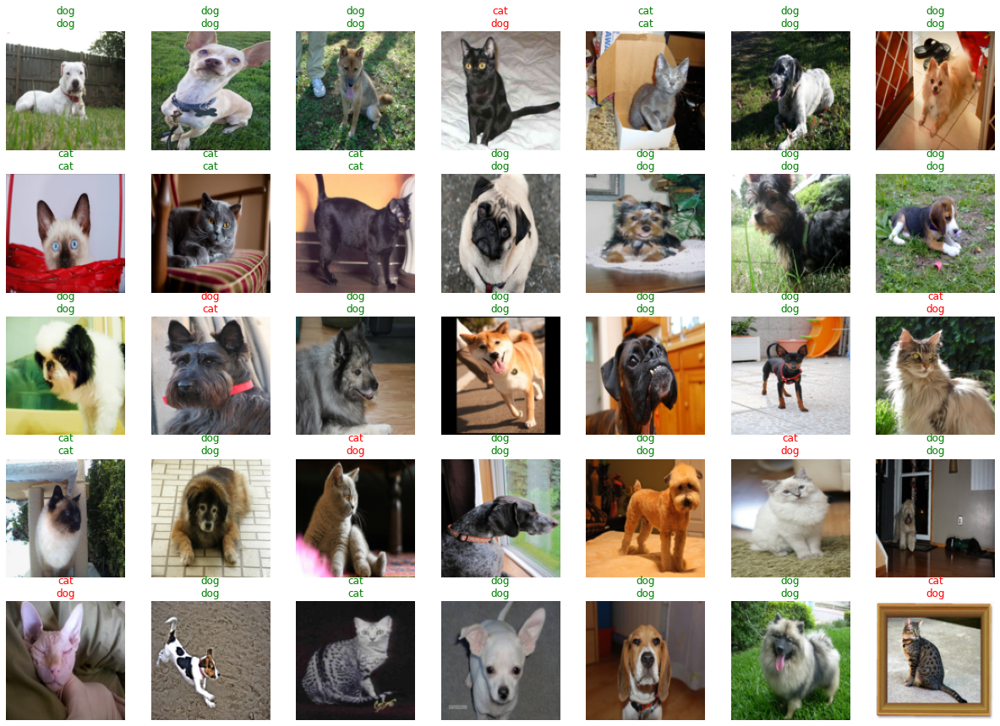

In [118]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

# Oxford-III Pets Dataset Dogs and Cats CNN Grayscale

In [146]:
pet_path = untar_data(URLs.PETS)
pet_path

Path('/root/.fastai/data/oxford-iiit-pet')

In [147]:
pet_path.ls()

(#2) [Path('/root/.fastai/data/oxford-iiit-pet/images'),Path('/root/.fastai/data/oxford-iiit-pet/annotations')]

In [148]:
(pet_path / 'images').ls()

(#7393) [Path('/root/.fastai/data/oxford-iiit-pet/images/Ragdoll_119.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Birman_56.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/havanese_69.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Bengal_132.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Bombay_81.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Bengal_191.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/pug_202.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_67.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/scottish_terrier_10.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/great_pyrenees_181.jpg')...]

In [149]:
pet_image_paths = get_image_files((pet_path / 'images'))
pet_image_paths.sort()
pet_image_paths

(#7390) [Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_1.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_10.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_100.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_101.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_102.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_103.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_104.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_105.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_106.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_107.jpg')...]

In [150]:
pet_example = pet_image_paths[1]
pet_example

Path('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_10.jpg')

In [151]:
pet_example.name

'Abyssinian_10.jpg'

In [152]:
pet_example.name[0]

'A'

In [153]:
pet_example.name[0].isupper()

True

In [154]:
def label_func(fname):
    return "cat" if fname.name[0].isupper() else "dog"

In [155]:
label_func(pet_example)

'cat'

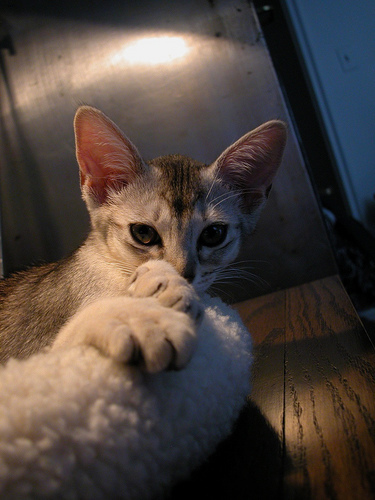

In [156]:
PILImage.create(pet_example)

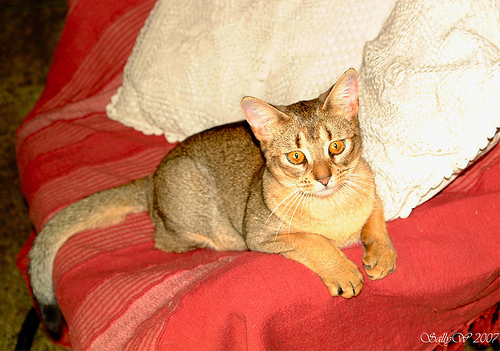

In [157]:
pet_example1 = pet_image_paths[5]
pet_img1 = PILImage.create(pet_example1)
pet_img1
#Example image

In [158]:
pet_img1.shape #CAN REMOVE

(351, 500)

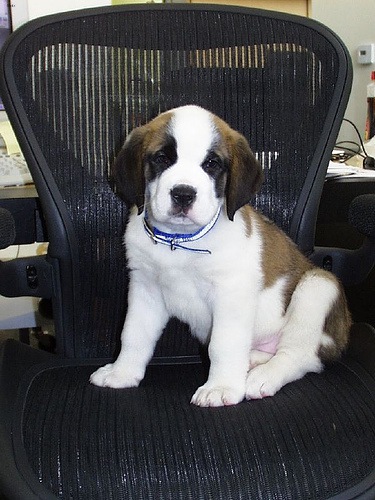

In [159]:
pet_example2 = pet_image_paths[6000]
pet_img2 = PILImage.create(pet_example2)
pet_img2
#Example image

In [160]:
pet_img2.shape#CAN REMOVE

(500, 375)

In [161]:
resize = Resize(128, method='squish')#CAN REMOVE

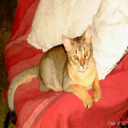

In [162]:
resize(pet_img1)#CAN REMOVE

In [163]:
resize(pet_img1).shape#CAN REMOVE

(128, 128)

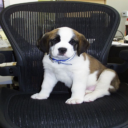

In [164]:
resize(pet_img2)#CAN REMOVE

In [165]:
resize(pet_img2).shape#CAN REMOVE

(128, 128)

In [166]:
labels = []

for i, img_path in enumerate(pet_image_paths):
    img_label = label_func(img_path)
    labels.append(img_label)
    
labels = np.array(labels)
labels

array(['cat', 'cat', 'cat', ..., 'dog', 'dog', 'dog'], dtype='<U3')

In [167]:
tts = TrainTestSplitter(test_size=.1, shuffle=True, stratify=labels, random_state=0)

In [168]:
trn_idx, tst_idx = tts(pet_image_paths)
trn_idx, tst_idx

((#6651) [778,2707,3973,472,3539,1938,1646,3237,815,2749...],
 (#739) [2536,3537,6617,637,1896,3948,5714,2076,807,797...])

In [169]:
trn_cls, trn_cls_cnt = np.unique(labels[list(trn_idx)], return_counts=True)

In [170]:
print("The {} class has for the training data has {} samples".format(trn_cls[0], 
                                                                      trn_cls_cnt[0]))
print("The {} class has for the training data has {} samples".format(trn_cls[1], 
                                                                      trn_cls_cnt[1]))
print("The training data cat-to-dog ratio is {:.5f} or {}/{} ".format(trn_cls_cnt[0]/trn_cls_cnt[1],
                                                                  trn_cls_cnt[0], trn_cls_cnt[1]))

The cat class has for the training data has 2160 samples
The dog class has for the training data has 4491 samples
The training data cat-to-dog ratio is 0.48096 or 2160/4491 


In [171]:
tst_cls, tst_cls_cnt =np.unique(labels[list(tst_idx)], return_counts=True)

In [172]:
print("The {} class has for the training data has {} samples".format(tst_cls[0], 
                                                                      tst_cls_cnt[0]))
print("The {} class has for the training data has {} samples".format(tst_cls[1], 
                                                                      tst_cls_cnt[1]))
print("The testing data cat-to-dog ratio is {:.5f} or {}/{} ".format(tst_cls_cnt[0]/tst_cls_cnt[1],
                                                                  tst_cls_cnt[0], tst_cls_cnt[1]))

The cat class has for the training data has 240 samples
The dog class has for the training data has 499 samples
The testing data cat-to-dog ratio is 0.48096 or 240/499 


In [173]:
trn_paths = pet_image_paths[trn_idx]
tst_paths  = pet_image_paths[tst_idx]

In [174]:
pet_db = DataBlock(
    blocks=(ImageBlock(cls=PILImageBW), CategoryBlock()),
    splitter=RandomSplitter(seed=0),
    get_y=label_func,
    item_tfms=Resize(128, method='squish')
)

In [175]:
trn_vld_dls = pet_db.dataloaders(trn_paths, bs=128)

In [176]:
trn_vld_dls.train_ds

(#5321) [(PILImageBW mode=L size=500x375, TensorCategory(1)),(PILImageBW mode=L size=500x333, TensorCategory(0)),(PILImageBW mode=L size=500x333, TensorCategory(0)),(PILImageBW mode=L size=500x376, TensorCategory(0)),(PILImageBW mode=L size=300x215, TensorCategory(1)),(PILImageBW mode=L size=500x375, TensorCategory(0)),(PILImageBW mode=L size=500x375, TensorCategory(1)),(PILImageBW mode=L size=500x375, TensorCategory(1)),(PILImageBW mode=L size=333x500, TensorCategory(1)),(PILImageBW mode=L size=500x333, TensorCategory(0))...]

In [177]:
trn_vld_dls.valid_ds

(#1330) [(PILImageBW mode=L size=500x359, TensorCategory(1)),(PILImageBW mode=L size=375x500, TensorCategory(1)),(PILImageBW mode=L size=500x323, TensorCategory(1)),(PILImageBW mode=L size=500x338, TensorCategory(1)),(PILImageBW mode=L size=352x319, TensorCategory(0)),(PILImageBW mode=L size=480x320, TensorCategory(1)),(PILImageBW mode=L size=500x375, TensorCategory(1)),(PILImageBW mode=L size=300x157, TensorCategory(0)),(PILImageBW mode=L size=500x375, TensorCategory(1)),(PILImageBW mode=L size=500x375, TensorCategory(1))...]

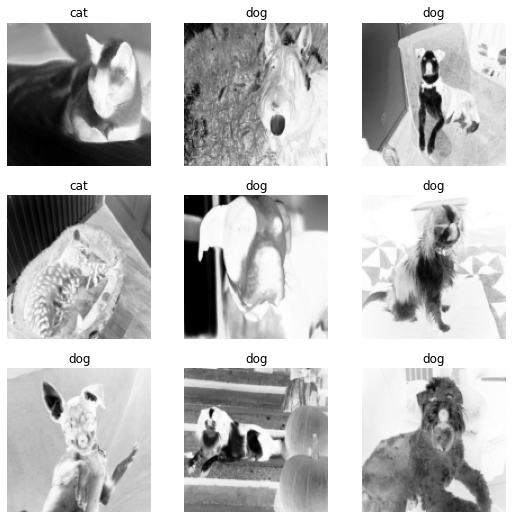

In [178]:
trn_vld_dls.show_batch()

In [179]:
x, y = trn_vld_dls.one_batch()
print("One batch of data has the shape: {}".format(x.shape))
print("One batch of targets has the shape: {}".format(y.shape))

One batch of data has the shape: torch.Size([128, 1, 128, 128])
One batch of targets has the shape: torch.Size([128])


In [180]:
test_dl = trn_vld_dls.test_dl(test_items=tst_paths, with_labels=True)
test_dl.dataset

(#739) [(PILImageBW mode=L size=500x375, TensorCategory(1)),(PILImageBW mode=L size=300x500, TensorCategory(1)),(PILImageBW mode=L size=500x375, TensorCategory(1)),(PILImageBW mode=L size=360x305, TensorCategory(0)),(PILImageBW mode=L size=500x442, TensorCategory(0)),(PILImageBW mode=L size=500x333, TensorCategory(1)),(PILImageBW mode=L size=500x333, TensorCategory(1)),(PILImageBW mode=L size=500x346, TensorCategory(0)),(PILImageBW mode=L size=500x375, TensorCategory(0)),(PILImageBW mode=L size=450x342, TensorCategory(0))...]

In [181]:
cnn_layers = nn.Sequential(
    nn.Conv2d(in_channels=1, out_channels=32, kernel_size=3),
    nn.ReLU(),
    nn.MaxPool2d(kernel_size=2),
    nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3),
    nn.ReLU(),
    nn.MaxPool2d(kernel_size=2),
    nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3),
    nn.ReLU(),
    nn.MaxPool2d(kernel_size=2)
).to(device)

In [182]:
x, y = trn_vld_dls.one_batch()
cnn_output = cnn_layers(x)
cnn_output.shape

torch.Size([128, 128, 14, 14])

In [183]:
fc_layers = nn.Sequential(
    nn.Flatten(),
    nn.Linear(in_features=25088, out_features=128),
    nn.ReLU(),
    nn.Linear(in_features=128, out_features=2),
    nn.LogSoftmax()
).to(device)

In [184]:
fc_output = fc_layers(cnn_output)
fc_output.shape

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


torch.Size([128, 2])

In [185]:
model = nn.Sequential(*cnn_layers, *fc_layers)

In [186]:
summary(model, x.shape[1:]);

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 126, 126]             320
              ReLU-2         [-1, 32, 126, 126]               0
         MaxPool2d-3           [-1, 32, 63, 63]               0
            Conv2d-4           [-1, 64, 61, 61]          18,496
              ReLU-5           [-1, 64, 61, 61]               0
         MaxPool2d-6           [-1, 64, 30, 30]               0
            Conv2d-7          [-1, 128, 28, 28]          73,856
              ReLU-8          [-1, 128, 28, 28]               0
         MaxPool2d-9          [-1, 128, 14, 14]               0
          Flatten-10                [-1, 25088]               0
           Linear-11                  [-1, 128]       3,211,392
             ReLU-12                  [-1, 128]               0
           Linear-13                    [-1, 2]             258
       LogSoftmax-14                   

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:141: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


In [187]:
nll_loss = BaseLoss(nn.NLLLoss)

def decode_nllloss(x):
    return x.argmax(axis=1)
nll_loss.decodes = decode_nllloss

reset_model(model)

learn = Learner(dls=trn_vld_dls,
                model=model,
                loss_func=nll_loss,
                metrics=accuracy,
                opt_func=Adam)

In [188]:
learn.fit(3, .001)

epoch,train_loss,valid_loss,accuracy,time
0,0.633695,0.635587,0.657143,00:50
1,0.608584,0.594474,0.664662,00:40
2,0.583814,0.570813,0.700000,00:41


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


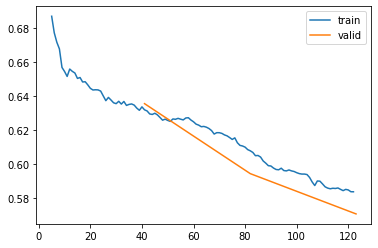

In [189]:
learn.recorder.plot_loss()

In [190]:
tst_logprobs, tst_targets = learn.get_preds(dl=test_dl)

tst_preds = np.argmax(tst_logprobs, axis=0)

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


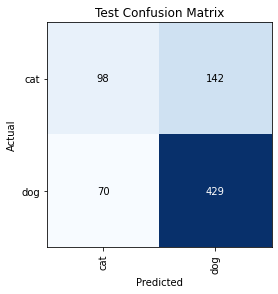

In [191]:
tst_interp = ClassificationInterpretation.from_learner(learn=learn, dl=test_dl)

tst_interp.plot_confusion_matrix(title="Test Confusion Matrix")

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


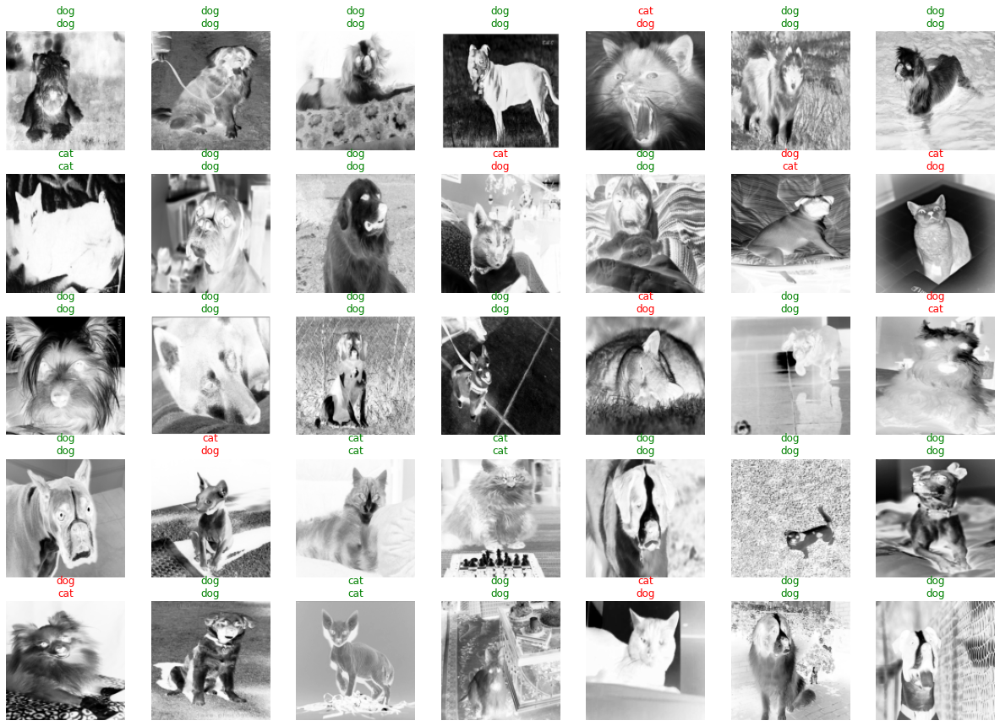

In [192]:
learn.show_results(max_n=35, shuffle=False)

# Transfer Learning with Pets Database (ResNet34, NLLLoss, Adam)

In [232]:
resnet = resnet34(pretrained=True).to(device)

In [233]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 1000])

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


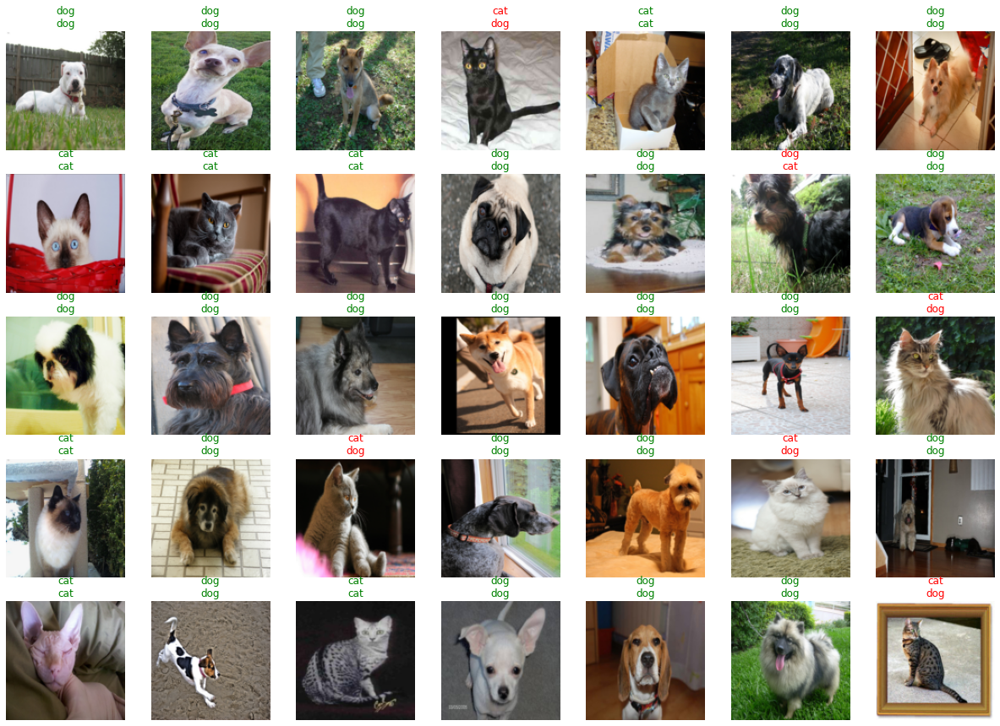

In [234]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

In [235]:
list(resnet.children())[:-1]

[Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False),
 BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False),
 Sequential(
   (0): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   )
   (1): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), pad

In [236]:
resnet = nn.Sequential(*list(resnet.children())[:-1])

In [237]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 512, 1, 1])

In [238]:
summary(resnet, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [239]:
fc_layers = nn.Sequential(
    nn.Flatten(),
    nn.Linear(in_features=512, out_features=2),
    nn.LogSoftmax()
).to(device)

In [240]:
model = nn.Sequential(OrderedDict([('feature_extractor', resnet), 
                                       ('classifier', fc_layers)]))

In [241]:
x, y = trn_vld_dls.one_batch()
model_output = model(x)
model_output.shape

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


torch.Size([128, 2])

In [242]:
summary(model, x.shape[1:])

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:141: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [243]:
nll_loss = BaseLoss(nn.NLLLoss)

def decode_loss(x):
    return x.argmax(axis=1)
nll_loss.decodes = decode_loss

from collections import OrderedDict

def resnet_splitter(model):
    def params(m):
        return [p for p in m.parameters()]
    return [params(model.feature_extractor), params(model.classifier)]


learn = Learner(trn_vld_dls, 
                model, 
                opt_func=Adam, 
                loss_func=nll_loss, 
                metrics=accuracy,
                splitter=resnet_splitter)

In [244]:
learn.freeze()

In [245]:
learn.summary()

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Sequential (Input shape: 128 x 3 x 128 x 128)
Layer (type)         Output Shape         Param #    Trainable 
                     128 x 64 x 64 x 64  
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     128 x 64 x 32 x 32  
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

In [246]:
learn.fit(3, .001)

epoch,train_loss,valid_loss,accuracy,time
0,0.241113,0.131138,0.950376,00:49
1,0.124096,0.084508,0.972932,00:48
2,0.071207,0.078331,0.969173,00:48


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


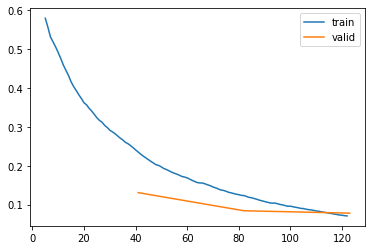

In [247]:
learn.recorder.plot_loss()

In [248]:
tst_logprobs, tst_targets = learn.get_preds(dl=test_dl)
tst_loss, tst_acc = learn.validate(dl=test_dl)
tst_preds = tst_logprobs.argmax(axis=1)
print("Test loss: {:.5f} accuracy: {:.5f}".format(tst_loss, tst_acc))

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Test loss: 0.06324 accuracy: 0.97700


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


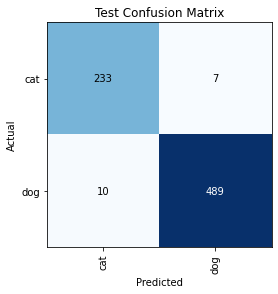

In [249]:
tst_interp = ClassificationInterpretation.from_learner(learn, dl=test_dl)

tst_interp.plot_confusion_matrix(title="Test Confusion Matrix")

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


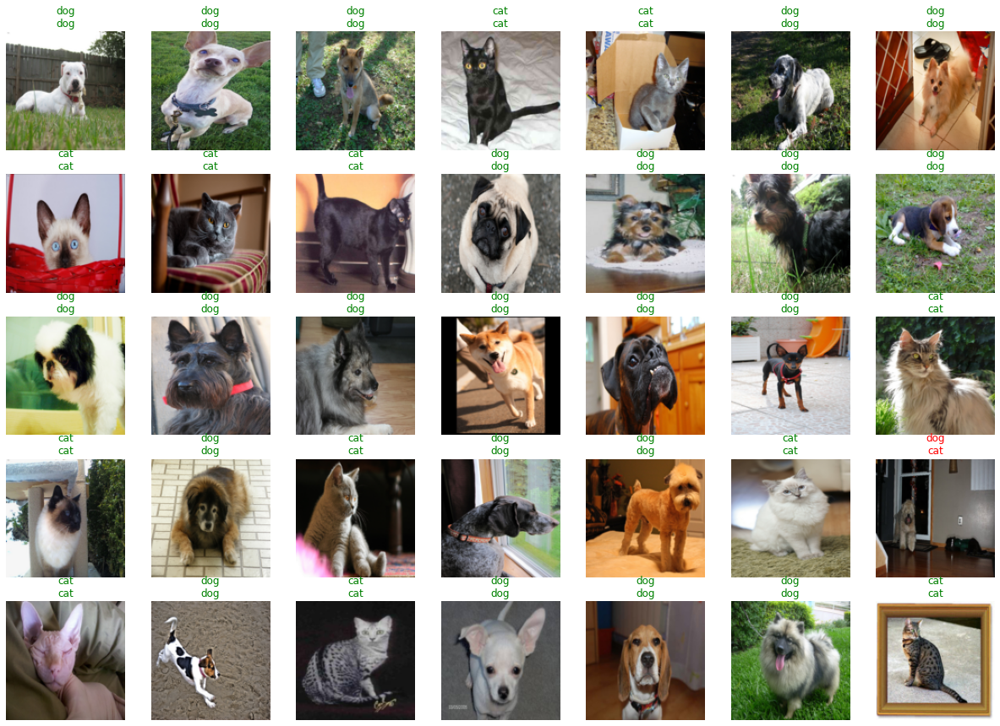

In [250]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

# Transfer Learning with Pets Database (ResNet34, CrossEntropyLoss, Adam)

In [119]:
resnet = resnet34(pretrained=True).to(device)

In [120]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 1000])

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


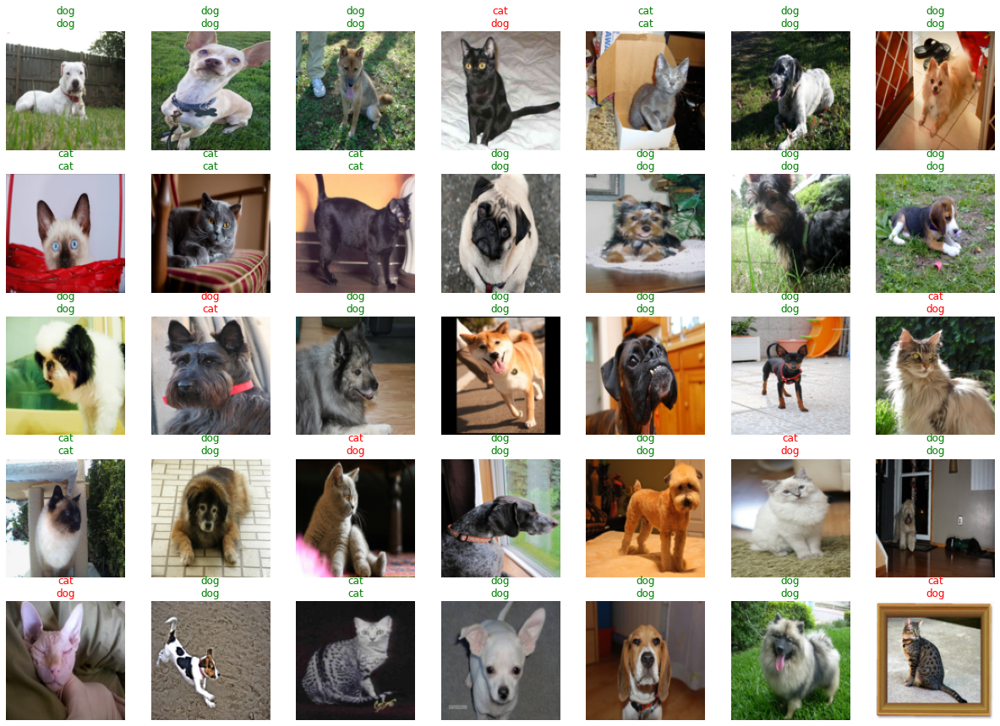

In [121]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

In [122]:
list(resnet.children())[:-1]

[Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False),
 BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False),
 Sequential(
   (0): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   )
   (1): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), pad

In [123]:
resnet = nn.Sequential(*list(resnet.children())[:-1])

In [124]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 512, 1, 1])

In [125]:
summary(resnet, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [126]:
fc_layers = nn.Sequential(
    nn.Flatten(),
    nn.Linear(in_features=512, out_features=2),
    nn.LogSoftmax()
).to(device)

In [127]:
model = nn.Sequential(OrderedDict([('feature_extractor', resnet), 
                                       ('classifier', fc_layers)]))

In [128]:
x, y = trn_vld_dls.one_batch()
model_output = model(x)
model_output.shape

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


torch.Size([128, 2])

In [129]:
summary(model, x.shape[1:])

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:141: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [130]:
cross_entropy_loss = BaseLoss(nn.CrossEntropyLoss)

def decode_loss(x):
    return x.argmax(axis=1)
cross_entropy_loss.decodes = decode_loss

from collections import OrderedDict

def resnet_splitter(model):
    def params(m):
        return [p for p in m.parameters()]
    return [params(model.feature_extractor), params(model.classifier)]


learn = Learner(trn_vld_dls, 
                model, 
                opt_func=Adam, 
                loss_func=cross_entropy_loss, 
                metrics=accuracy,
                splitter=resnet_splitter)

In [131]:
learn.freeze()

In [132]:
learn.summary()

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Sequential (Input shape: 128 x 3 x 128 x 128)
Layer (type)         Output Shape         Param #    Trainable 
                     128 x 64 x 64 x 64  
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     128 x 64 x 32 x 32  
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

In [133]:
learn.fit(3, .001)

epoch,train_loss,valid_loss,accuracy,time
0,0.234196,0.113745,0.960902,00:52
1,0.120866,0.084448,0.971429,00:50
2,0.069963,0.078776,0.973684,00:52


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


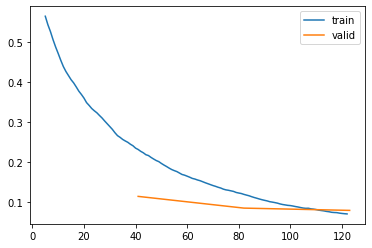

In [134]:
learn.recorder.plot_loss()

In [135]:
tst_logprobs, tst_targets = learn.get_preds(dl=test_dl)
tst_loss, tst_acc = learn.validate(dl=test_dl)
tst_preds = tst_logprobs.argmax(axis=1)
print("Test loss: {:.5f} accuracy: {:.5f}".format(tst_loss, tst_acc))

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Test loss: 0.06912 accuracy: 0.96752


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


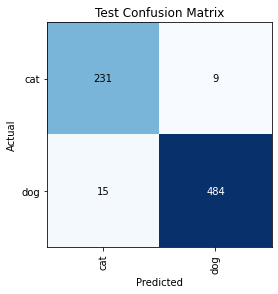

In [136]:
tst_interp = ClassificationInterpretation.from_learner(learn, dl=test_dl)

tst_interp.plot_confusion_matrix(title="Test Confusion Matrix")

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


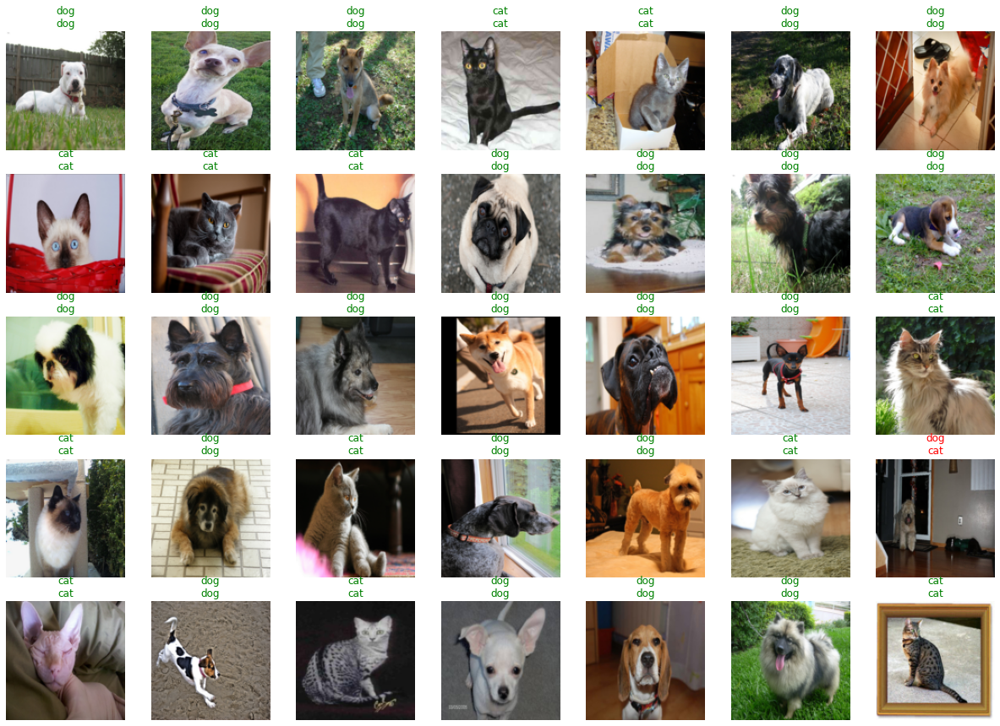

In [137]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

# Transfer Learning with Pets Database (ResNet18, NLLLoss, Adam)

In [130]:
resnet = resnet18(pretrained=True).to(device)

In [131]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 1000])

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


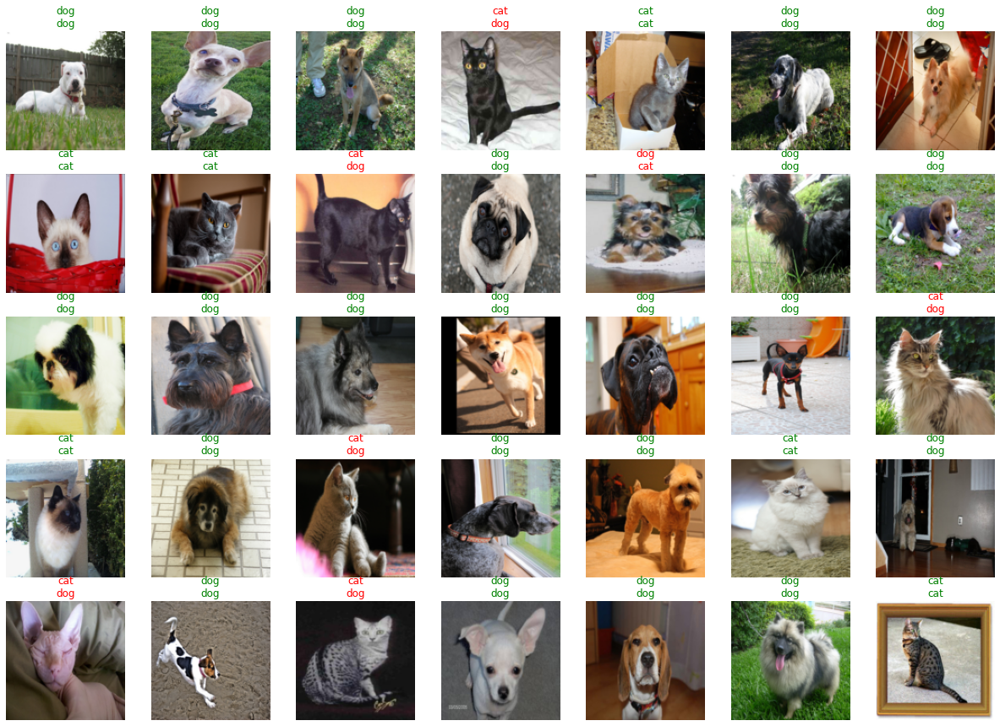

In [132]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

In [133]:
list(resnet.children())[:-1]

[Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False),
 BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False),
 Sequential(
   (0): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   )
   (1): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), pad

In [134]:
resnet = nn.Sequential(*list(resnet.children())[:-1])

In [135]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 512, 1, 1])

In [136]:
summary(resnet, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [137]:
fc_layers = nn.Sequential(
    nn.Flatten(),
    nn.Linear(in_features=512, out_features=2),
    nn.LogSoftmax()
).to(device)

In [138]:
model = nn.Sequential(OrderedDict([('feature_extractor', resnet), 
                                       ('classifier', fc_layers)]))

In [139]:
x, y = trn_vld_dls.one_batch()
model_output = model(x)
model_output.shape

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


torch.Size([128, 2])

In [140]:
summary(model, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:141: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


In [141]:
nll_loss = BaseLoss(nn.NLLLoss)

def decode_loss(x):
    return x.argmax(axis=1)
nll_loss.decodes = decode_loss

from collections import OrderedDict

def resnet_splitter(model):
    def params(m):
        return [p for p in m.parameters()]
    return [params(model.feature_extractor), params(model.classifier)]


learn = Learner(trn_vld_dls, 
                model, 
                opt_func=Adam, 
                loss_func=nll_loss, 
                metrics=accuracy,
                splitter=resnet_splitter)

In [142]:
learn.freeze()

In [143]:
learn.summary()

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Sequential (Input shape: 128 x 3 x 128 x 128)
Layer (type)         Output Shape         Param #    Trainable 
                     128 x 64 x 64 x 64  
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     128 x 64 x 32 x 32  
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

In [144]:
learn.fit(3, .001)

epoch,train_loss,valid_loss,accuracy,time
0,0.279195,0.138851,0.947368,00:46
1,0.161145,0.102633,0.958647,00:45
2,0.106230,0.094658,0.959399,00:46


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


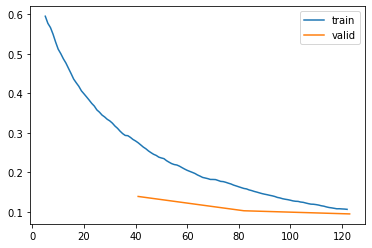

In [145]:
learn.recorder.plot_loss()

In [146]:
tst_logprobs, tst_targets = learn.get_preds(dl=test_dl)
tst_loss, tst_acc = learn.validate(dl=test_dl)
tst_preds = tst_logprobs.argmax(axis=1)
print("Test loss: {:.5f} accuracy: {:.5f}".format(tst_loss, tst_acc))

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Test loss: 0.06784 accuracy: 0.97294


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


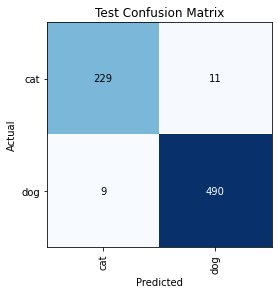

In [147]:
tst_interp = ClassificationInterpretation.from_learner(learn, dl=test_dl)

tst_interp.plot_confusion_matrix(title="Test Confusion Matrix")

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


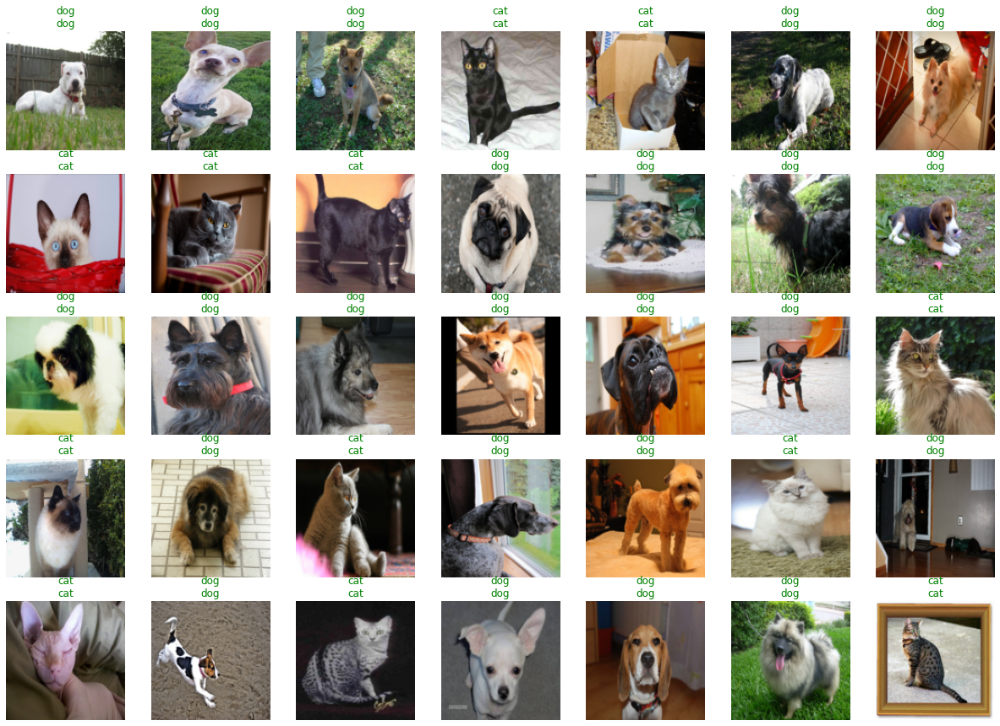

In [148]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

# Transfer Learning with Pets Database (ResNet18, CrossEntropyLoss, Adam)

In [149]:
resnet = resnet18(pretrained=True).to(device)

In [150]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 1000])

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


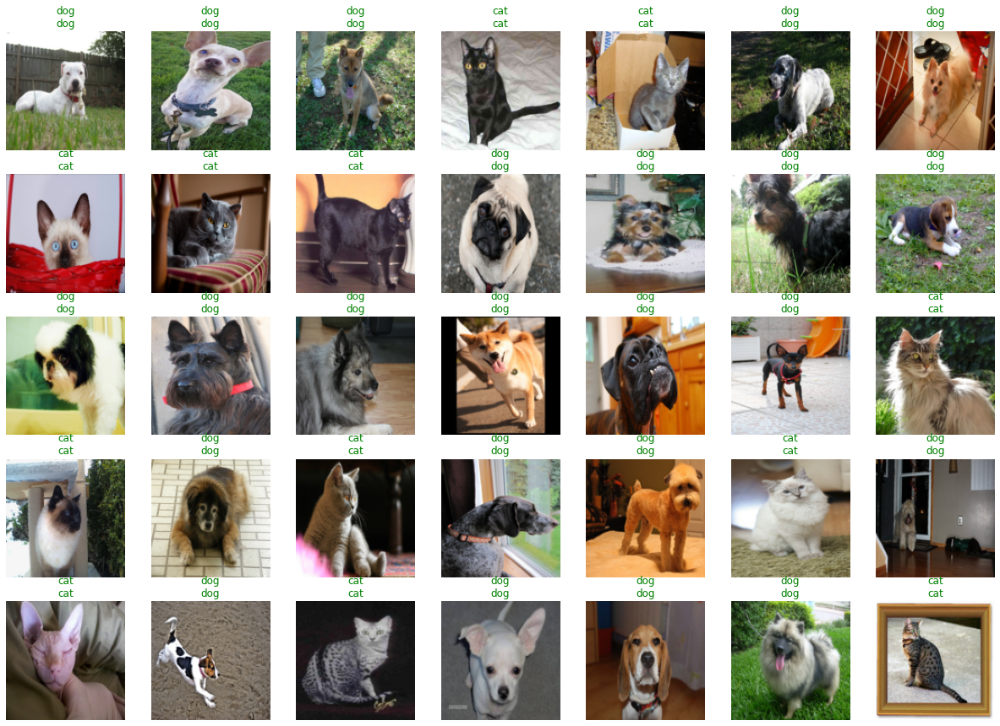

In [151]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

In [152]:
list(resnet.children())[:-1]

[Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False),
 BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False),
 Sequential(
   (0): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   )
   (1): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), pad

In [153]:
resnet = nn.Sequential(*list(resnet.children())[:-1])

In [154]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 512, 1, 1])

In [155]:
summary(resnet, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [156]:
fc_layers = nn.Sequential(
    nn.Flatten(),
    nn.Linear(in_features=512, out_features=2),
    nn.LogSoftmax()
).to(device)

In [157]:
model = nn.Sequential(OrderedDict([('feature_extractor', resnet), 
                                       ('classifier', fc_layers)]))

In [158]:
x, y = trn_vld_dls.one_batch()
model_output = model(x)
model_output.shape

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


torch.Size([128, 2])

In [159]:
summary(model, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:141: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


In [160]:
cross_entropy_loss = BaseLoss(nn.CrossEntropyLoss)

def decode_loss(x):
    return x.argmax(axis=1)
cross_entropy_loss.decodes = decode_loss

from collections import OrderedDict

def resnet_splitter(model):
    def params(m):
        return [p for p in m.parameters()]
    return [params(model.feature_extractor), params(model.classifier)]


learn = Learner(trn_vld_dls, 
                model, 
                opt_func=Adam, 
                loss_func=cross_entropy_loss, 
                metrics=accuracy,
                splitter=resnet_splitter)

In [161]:
learn.freeze()

In [162]:
learn.summary()

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Sequential (Input shape: 128 x 3 x 128 x 128)
Layer (type)         Output Shape         Param #    Trainable 
                     128 x 64 x 64 x 64  
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     128 x 64 x 32 x 32  
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

In [163]:
learn.fit(3, .001)

epoch,train_loss,valid_loss,accuracy,time
0,0.284374,0.153349,0.936090,00:47
1,0.165297,0.111901,0.950376,00:47
2,0.108404,0.106282,0.954135,00:46


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


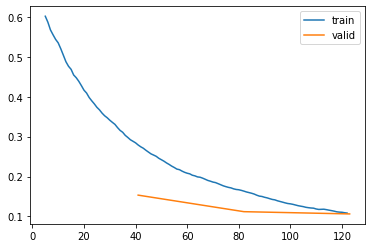

In [164]:
learn.recorder.plot_loss()

In [165]:
tst_logprobs, tst_targets = learn.get_preds(dl=test_dl)
tst_loss, tst_acc = learn.validate(dl=test_dl)
tst_preds = tst_logprobs.argmax(axis=1)
print("Test loss: {:.5f} accuracy: {:.5f}".format(tst_loss, tst_acc))

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Test loss: 0.07763 accuracy: 0.97294


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


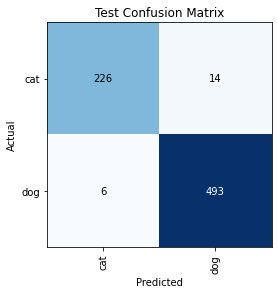

In [166]:
tst_interp = ClassificationInterpretation.from_learner(learn, dl=test_dl)

tst_interp.plot_confusion_matrix(title="Test Confusion Matrix")

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


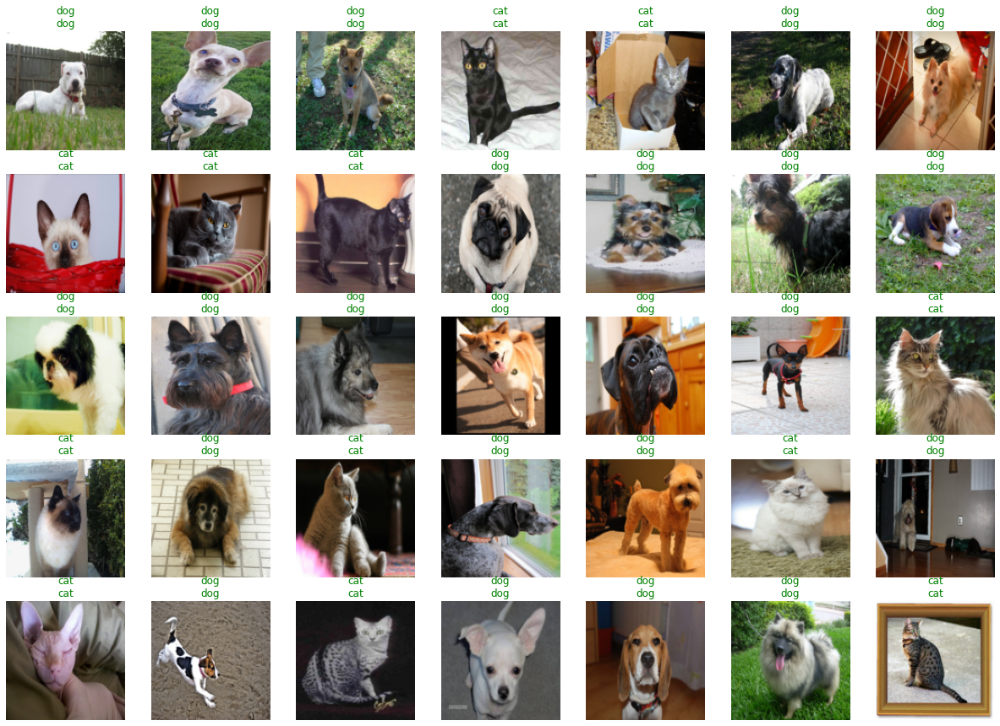

In [167]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

# Transfer Learning with Pets Database (ResNet34, NLLLoss, SGD)

In [87]:
resnet = resnet34(pretrained=True).to(device)

In [88]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 1000])

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


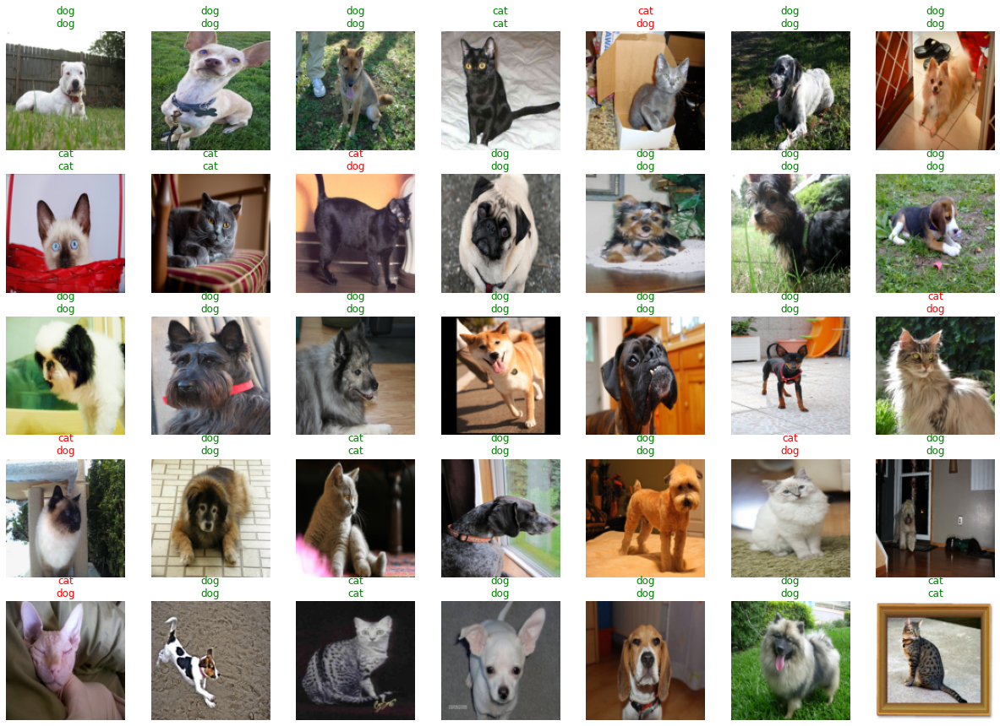

In [89]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

In [90]:
list(resnet.children())[:-1]

[Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False),
 BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False),
 Sequential(
   (0): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   )
   (1): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), pad

In [91]:
resnet = nn.Sequential(*list(resnet.children())[:-1])

In [92]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 512, 1, 1])

In [93]:
summary(resnet, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [94]:
fc_layers = nn.Sequential(
    nn.Flatten(),
    nn.Linear(in_features=512, out_features=2),
    nn.LogSoftmax()
).to(device)

In [95]:
model = nn.Sequential(OrderedDict([('feature_extractor', resnet), 
                                       ('classifier', fc_layers)]))

In [96]:
x, y = trn_vld_dls.one_batch()
model_output = model(x)
model_output.shape

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


torch.Size([128, 2])

In [97]:
summary(model, x.shape[1:])

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:141: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [100]:
nll_loss = BaseLoss(nn.NLLLoss)

def decode_loss(x):
    return x.argmax(axis=1)
nll_loss.decodes = decode_loss

from collections import OrderedDict

def resnet_splitter(model):
    def params(m):
        return [p for p in m.parameters()]
    return [params(model.feature_extractor), params(model.classifier)]


learn = Learner(trn_vld_dls, 
                model, 
                opt_func=SGD, 
                loss_func=nll_loss, 
                metrics=accuracy,
                splitter=resnet_splitter)

In [101]:
learn.freeze()

In [102]:
learn.summary()

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Sequential (Input shape: 128 x 3 x 128 x 128)
Layer (type)         Output Shape         Param #    Trainable 
                     128 x 64 x 64 x 64  
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     128 x 64 x 32 x 32  
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

In [103]:
learn.fit(3, .001)

epoch,train_loss,valid_loss,accuracy,time
0,0.632439,0.553222,0.696992,00:48
1,0.524135,0.444668,0.778196,00:48
2,0.446534,0.384158,0.817293,00:50


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


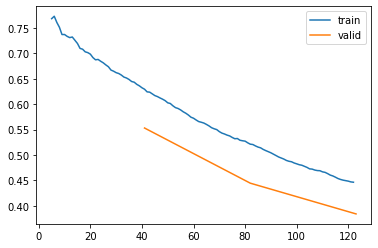

In [104]:
learn.recorder.plot_loss()

In [105]:
tst_logprobs, tst_targets = learn.get_preds(dl=test_dl)
tst_loss, tst_acc = learn.validate(dl=test_dl)
tst_preds = tst_logprobs.argmax(axis=1)
print("Test loss: {:.5f} accuracy: {:.5f}".format(tst_loss, tst_acc))

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Test loss: 0.36110 accuracy: 0.84709


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


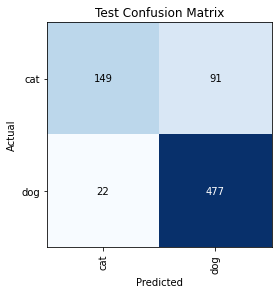

In [106]:
tst_interp = ClassificationInterpretation.from_learner(learn, dl=test_dl)

tst_interp.plot_confusion_matrix(title="Test Confusion Matrix")

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


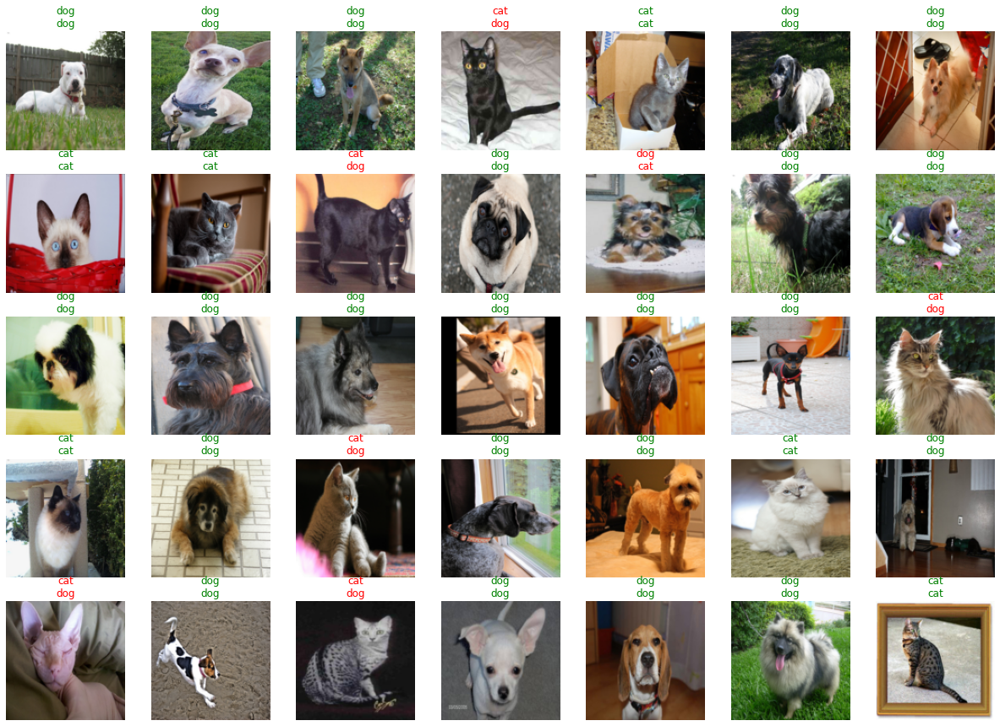

In [107]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

# Transfer Learning with Pets Database (ResNet34, CrossEntropyLoss, SGD)

In [68]:
resnet = resnet34(pretrained=True).to(device)

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


  0%|          | 0.00/83.3M [00:00<?, ?B/s]

In [69]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 1000])

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


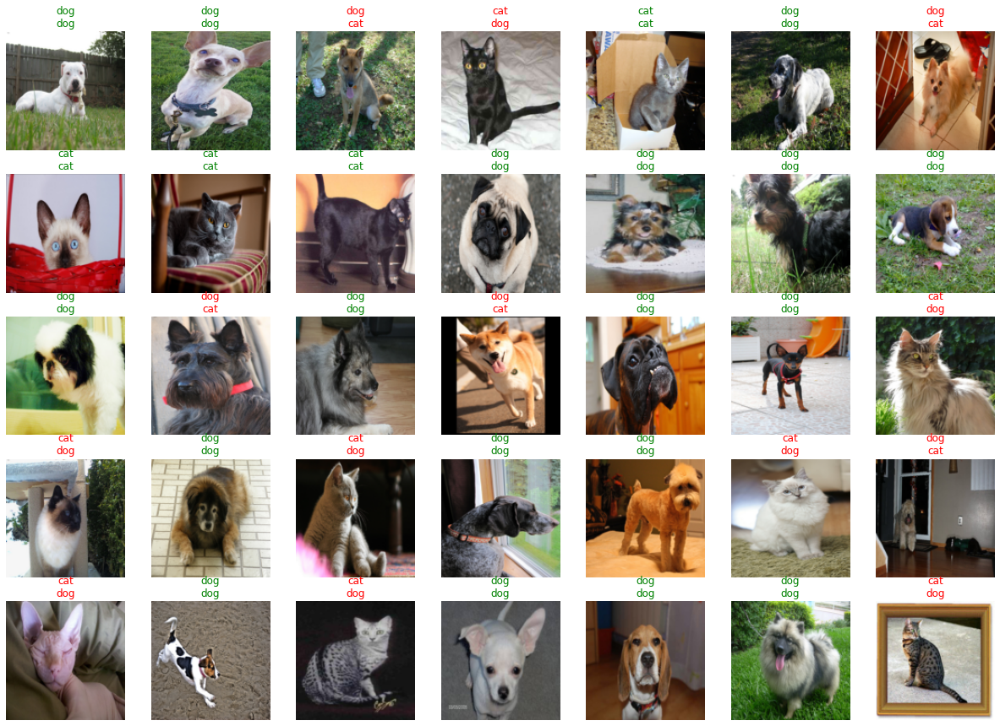

In [70]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

In [71]:
list(resnet.children())[:-1]

[Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False),
 BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False),
 Sequential(
   (0): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   )
   (1): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), pad

In [72]:
resnet = nn.Sequential(*list(resnet.children())[:-1])

In [73]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 512, 1, 1])

In [74]:
summary(resnet, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [75]:
fc_layers = nn.Sequential(
    nn.Flatten(),
    nn.Linear(in_features=512, out_features=2),
    nn.LogSoftmax()
).to(device)

In [76]:
model = nn.Sequential(OrderedDict([('feature_extractor', resnet), 
                                       ('classifier', fc_layers)]))

In [77]:
x, y = trn_vld_dls.one_batch()
model_output = model(x)
model_output.shape

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


torch.Size([128, 2])

In [78]:
summary(model, x.shape[1:])

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:141: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [79]:
cross_entropy_loss = BaseLoss(nn.CrossEntropyLoss)

def decode_loss(x):
    return x.argmax(axis=1)
cross_entropy_loss.decodes = decode_loss

from collections import OrderedDict

def resnet_splitter(model):
    def params(m):
        return [p for p in m.parameters()]
    return [params(model.feature_extractor), params(model.classifier)]


learn = Learner(trn_vld_dls, 
                model, 
                opt_func=SGD, 
                loss_func=cross_entropy_loss, 
                metrics=accuracy,
                splitter=resnet_splitter)

In [80]:
learn.freeze()

In [81]:
learn.summary()

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Sequential (Input shape: 128 x 3 x 128 x 128)
Layer (type)         Output Shape         Param #    Trainable 
                     128 x 64 x 64 x 64  
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     128 x 64 x 32 x 32  
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

In [82]:
learn.fit(3, .001)

epoch,train_loss,valid_loss,accuracy,time
0,0.576676,0.525566,0.717293,00:49
1,0.486499,0.432556,0.796992,00:49
2,0.422175,0.373034,0.838346,00:47


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


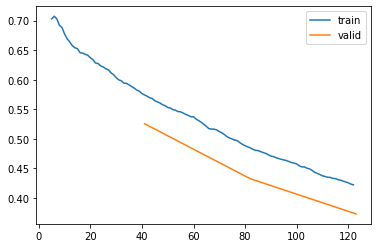

In [83]:
learn.recorder.plot_loss()

In [84]:
tst_logprobs, tst_targets = learn.get_preds(dl=test_dl)
tst_loss, tst_acc = learn.validate(dl=test_dl)
tst_preds = tst_logprobs.argmax(axis=1)
print("Test loss: {:.5f} accuracy: {:.5f}".format(tst_loss, tst_acc))

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Test loss: 0.36126 accuracy: 0.84844


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


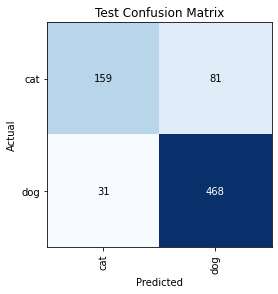

In [85]:
tst_interp = ClassificationInterpretation.from_learner(learn, dl=test_dl)

tst_interp.plot_confusion_matrix(title="Test Confusion Matrix")

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


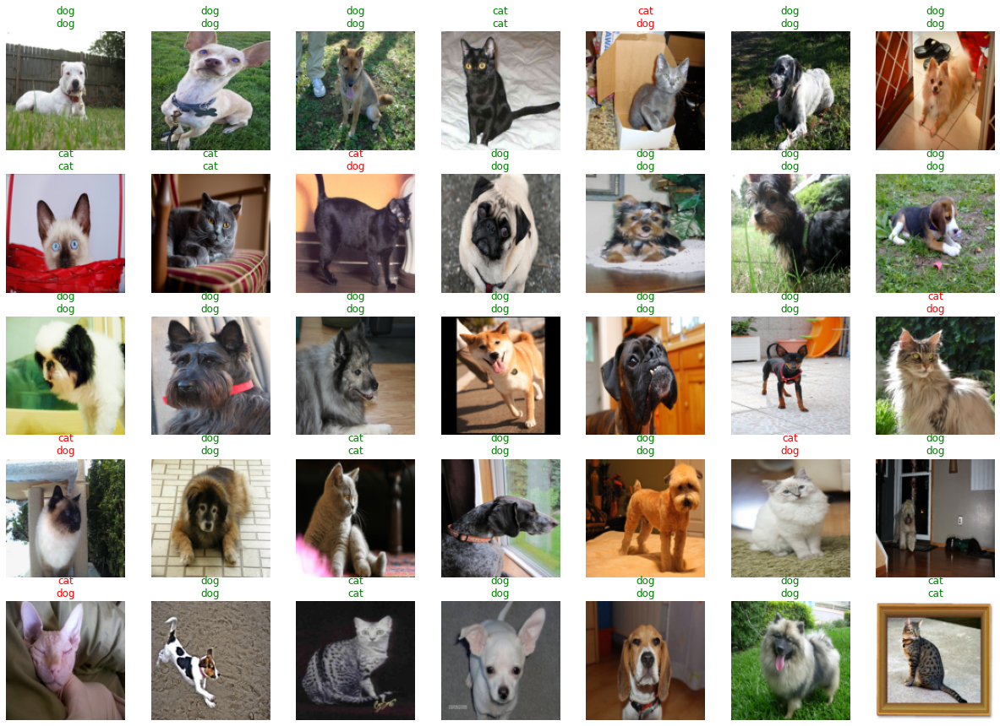

In [86]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

# Transfer Learning with Pets Database (ResNet18, NLLLoss, SGD)

In [168]:
resnet = resnet18(pretrained=True).to(device)

In [169]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 1000])

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


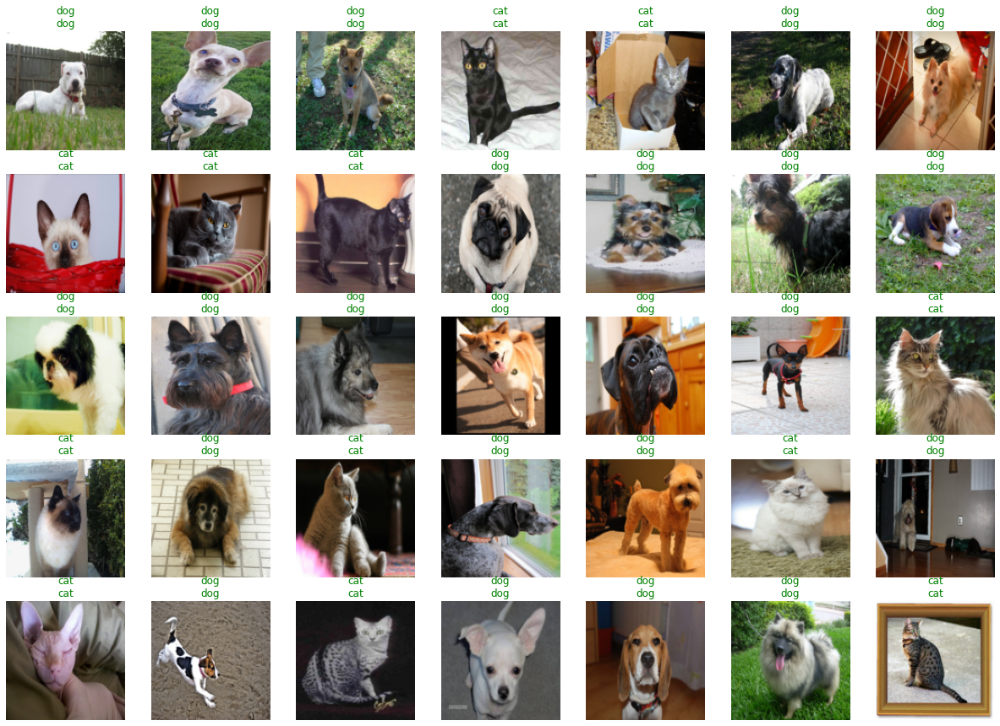

In [170]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

In [171]:
list(resnet.children())[:-1]

[Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False),
 BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False),
 Sequential(
   (0): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   )
   (1): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), pad

In [172]:
resnet = nn.Sequential(*list(resnet.children())[:-1])

In [173]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 512, 1, 1])

In [174]:
summary(resnet, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [175]:
fc_layers = nn.Sequential(
    nn.Flatten(),
    nn.Linear(in_features=512, out_features=2),
    nn.LogSoftmax()
).to(device)

In [176]:
model = nn.Sequential(OrderedDict([('feature_extractor', resnet), 
                                       ('classifier', fc_layers)]))

In [177]:
x, y = trn_vld_dls.one_batch()
model_output = model(x)
model_output.shape

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


torch.Size([128, 2])

In [178]:
summary(model, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:141: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


In [179]:
nll_loss = BaseLoss(nn.NLLLoss)

def decode_loss(x):
    return x.argmax(axis=1)
nll_loss.decodes = decode_loss

from collections import OrderedDict

def resnet_splitter(model):
    def params(m):
        return [p for p in m.parameters()]
    return [params(model.feature_extractor), params(model.classifier)]


learn = Learner(trn_vld_dls, 
                model, 
                opt_func=SGD, 
                loss_func=nll_loss, 
                metrics=accuracy,
                splitter=resnet_splitter)

In [180]:
learn.freeze()

In [181]:
learn.summary()

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Sequential (Input shape: 128 x 3 x 128 x 128)
Layer (type)         Output Shape         Param #    Trainable 
                     128 x 64 x 64 x 64  
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     128 x 64 x 32 x 32  
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

In [182]:
learn.fit(3, .001)

epoch,train_loss,valid_loss,accuracy,time
0,0.624710,0.546055,0.720301,00:53
1,0.528010,0.451693,0.787970,00:46
2,0.458612,0.397347,0.823308,00:46


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


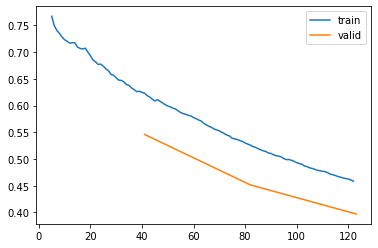

In [183]:
learn.recorder.plot_loss()

In [184]:
tst_logprobs, tst_targets = learn.get_preds(dl=test_dl)
tst_loss, tst_acc = learn.validate(dl=test_dl)
tst_preds = tst_logprobs.argmax(axis=1)
print("Test loss: {:.5f} accuracy: {:.5f}".format(tst_loss, tst_acc))

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Test loss: 0.39869 accuracy: 0.80514


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


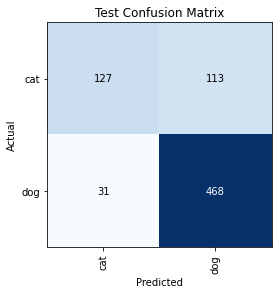

In [185]:
tst_interp = ClassificationInterpretation.from_learner(learn, dl=test_dl)

tst_interp.plot_confusion_matrix(title="Test Confusion Matrix")

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


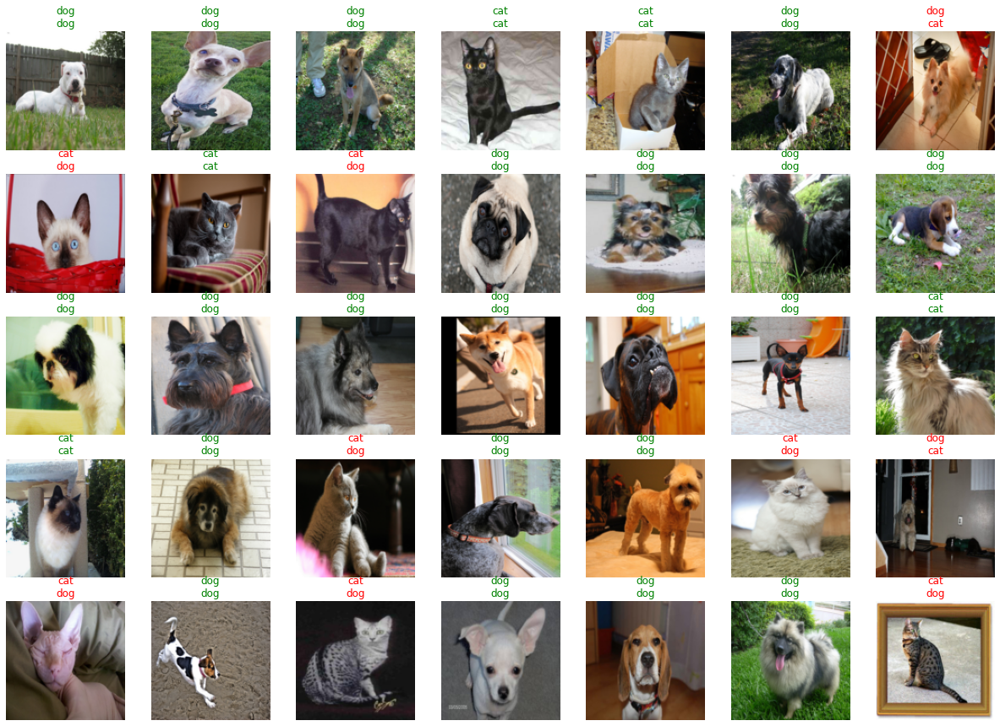

In [186]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

# Transfer Learning with Pets Database (ResNet18, CrossEntropyLoss, SGD)

In [187]:
resnet = resnet18(pretrained=True).to(device)

In [188]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 1000])

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


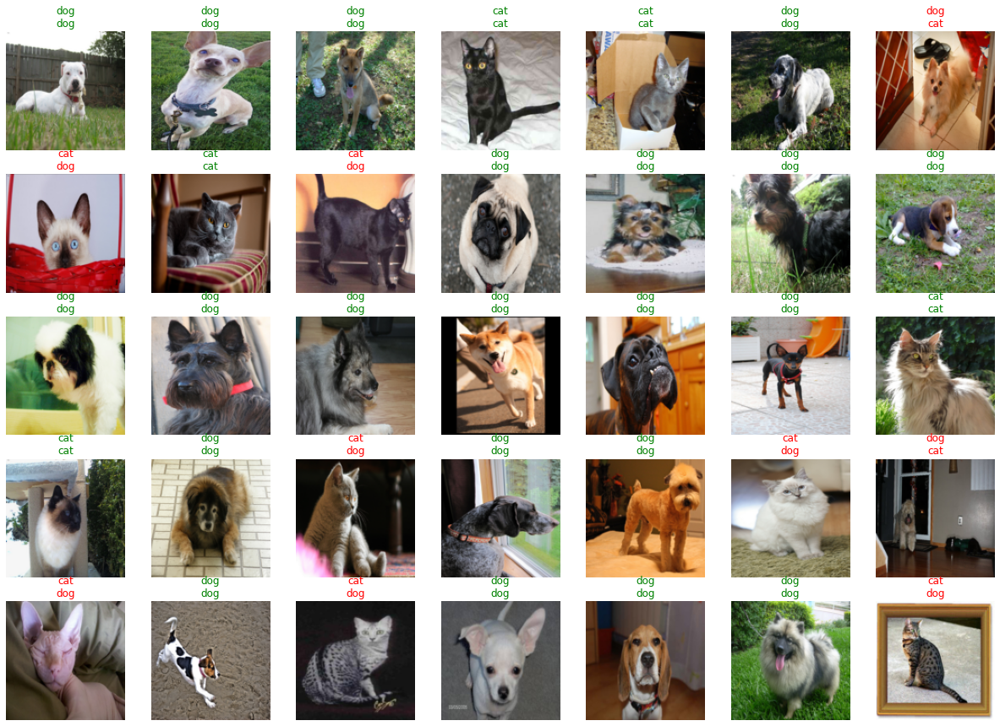

In [189]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)

In [190]:
list(resnet.children())[:-1]

[Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False),
 BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False),
 Sequential(
   (0): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   )
   (1): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), pad

In [191]:
resnet = nn.Sequential(*list(resnet.children())[:-1])

In [192]:
x, y = trn_vld_dls.one_batch()
resnet_output = resnet(x)
resnet_output.shape

torch.Size([128, 512, 1, 1])

In [193]:
summary(resnet, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [194]:
fc_layers = nn.Sequential(
    nn.Flatten(),
    nn.Linear(in_features=512, out_features=2),
    nn.LogSoftmax()
).to(device)

In [195]:
model = nn.Sequential(OrderedDict([('feature_extractor', resnet), 
                                       ('classifier', fc_layers)]))

In [196]:
x, y = trn_vld_dls.one_batch()
model_output = model(x)
model_output.shape

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


torch.Size([128, 2])

In [197]:
summary(model, x.shape[1:])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,408
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]          36,864
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
       BasicBlock-11           [-1, 64, 32, 32]               0
           Conv2d-12           [-1, 64, 32, 32]          36,864
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:141: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


In [198]:
cross_entropy_loss = BaseLoss(nn.CrossEntropyLoss)

def decode_loss(x):
    return x.argmax(axis=1)
cross_entropy_loss.decodes = decode_loss

from collections import OrderedDict

def resnet_splitter(model):
    def params(m):
        return [p for p in m.parameters()]
    return [params(model.feature_extractor), params(model.classifier)]


learn = Learner(trn_vld_dls, 
                model, 
                opt_func=SGD, 
                loss_func=cross_entropy_loss, 
                metrics=accuracy,
                splitter=resnet_splitter)

In [199]:
learn.freeze()

In [200]:
learn.summary()

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Sequential (Input shape: 128 x 3 x 128 x 128)
Layer (type)         Output Shape         Param #    Trainable 
                     128 x 64 x 64 x 64  
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     128 x 64 x 32 x 32  
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

In [201]:
learn.fit(3, .001)

epoch,train_loss,valid_loss,accuracy,time
0,0.658824,0.578194,0.679699,00:46
1,0.543819,0.478857,0.766165,00:46
2,0.466739,0.413165,0.811278,00:47


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


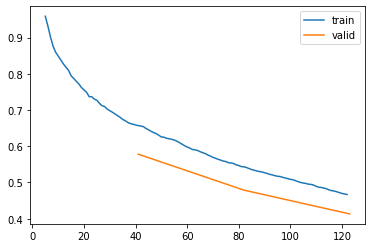

In [202]:
learn.recorder.plot_loss()

In [203]:
tst_logprobs, tst_targets = learn.get_preds(dl=test_dl)
tst_loss, tst_acc = learn.validate(dl=test_dl)
tst_preds = tst_logprobs.argmax(axis=1)
print("Test loss: {:.5f} accuracy: {:.5f}".format(tst_loss, tst_acc))

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


Test loss: 0.40547 accuracy: 0.80108


/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


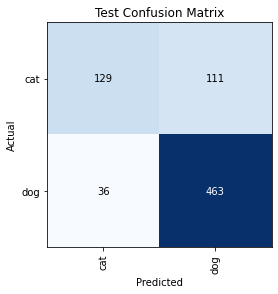

In [204]:
tst_interp = ClassificationInterpretation.from_learner(learn, dl=test_dl)

tst_interp.plot_confusion_matrix(title="Test Confusion Matrix")

/usr/local/lib/python3.7/dist-packages/torch/overrides.py:1355: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  result = torch_func_method(public_api, types, args, kwargs)


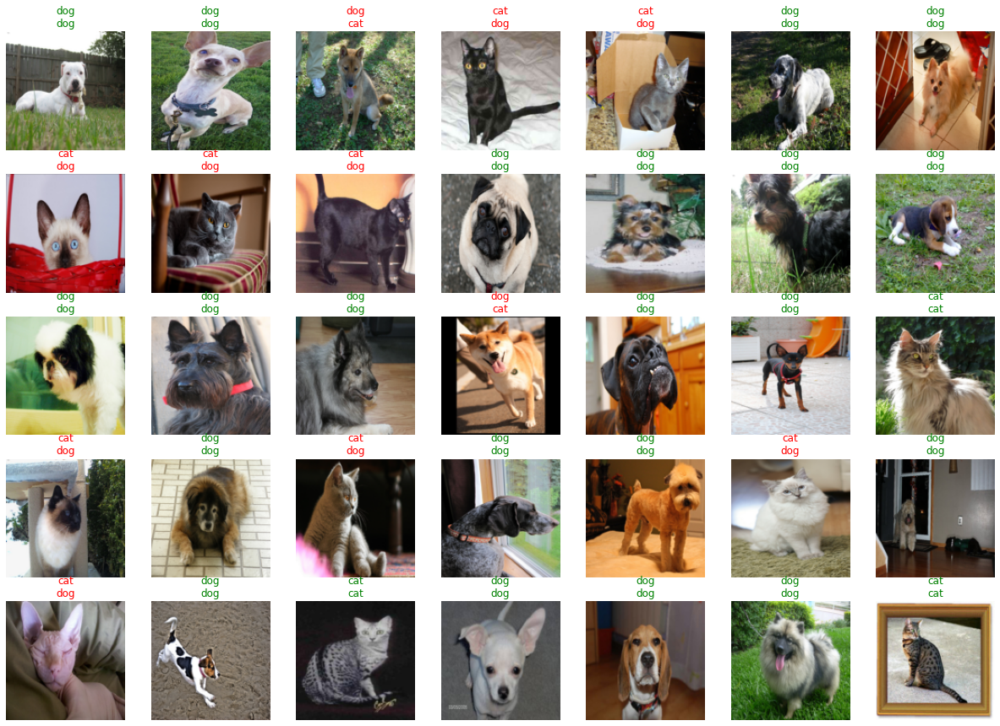

In [205]:
learn.show_results(max_n=35, dl=test_dl, shuffle=False)